# Introduction

L'objectif du mini-projet est de réaliser une attaque adversaire en segmentation en se basant sur ce qui se fait pour la classification. Nous nous sommes appuyés sur le TP Google Colab fourni ([TP_adversaire](https://colab.research.google.com/drive/1_H12sYUQpV5nTrT20N3zqKjYPCG62lOD?usp=sharing) d'Adrien Chan-Hon-Tong).

Remarque : Nous conseillons d'exécuter toutes les cellules dans l'ordre avec une session T4 GPU (de préférence).

In [ ]:
%autosave 10

# Pour avoir des images en meilleure qualité
%matplotlib inline
%config InlineBackend.figure_format = 'retina'



Autosaving every 10 seconds


In [ ]:
# Paramétrage de l'environnement

import os
import torch
import torchvision
import matplotlib.pyplot as plt
import torchvision.models.segmentation as segmentation
from numpy.random import rand
import time

# Activation du GPU pour accélérer les calculs :
# Il faut avoir sélectionné le runtime gpu
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("GPU disponible : ", torch.cuda.get_device_name(0))
else:
    device = torch.device("cpu")
    print("GPU non disponible, utilisation du CPU")


# Fonction de normalisation présente dans le Notebook originel
# Cette fonction rend les images "saturées", il faut donc "dénormaliser" les images attaquées avant de les afficher
normalize = torchvision.transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225]) # Pour normaliser les images, les adapter à ce que le modèle a appris ?

def denormalize(img):
  mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1)  # Moyenne utilisée pour la normalisation
  std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1)  # Écart type utilisé pour la normalisation
  denormalized = img * std + mean
  #denormalized = torch.clamp(denormalized, 0, 1)  # On s'assure que les valeurs sont dans [0, 1]
  return denormalized


# Fonctions de visualisation

def visualize_images(img,title) :
  visu = torchvision.utils.make_grid(img.cpu(),nrow=3) # On met les images en grille
  visu = torch.transpose(torch.transpose(visu, 0, 1),1,2) # Permutation des entrées pour pouvoir les afficher avec plt.imshow()
  plt.imshow(visu.numpy())
  plt.title(title)
  plt.show()


def visualize_prediction(img, pred, title):
  # Visualisation des images et des prédictions
    visu = torch.zeros(9, 3, 520, 520)
    visu[:, 0, :, :] = (pred == 1).float()  # Rouge pour humain
    visu[:, 1, :, :] = (pred == 2).float()  # Vert pour chat
    visu[:, 2, :, :] = (pred == 3).float()  # Bleu pour chien

    img_visu = torch.cat([denormalize(img.cpu()), visu.cpu()], dim=-1)  # Image + prédiction côte à côte
    img_visu = torchvision.utils.make_grid(img_visu, nrow=3)
    img_visu = torch.transpose(torch.transpose(img_visu, 0, 1), 1, 2)

    plt.imshow(img_visu.numpy())
    plt.title(title)
    plt.show()

def compare_images(img1, img2, title):
  # Affichage côte à côte de deux tenseurs d'image
  visu = torch.cat([denormalize(img1.cpu()), denormalize(img2.cpu())], dim=-1)  # On met les images originales et attaquées côte à côte
  visu = torchvision.utils.make_grid(visu, nrow=3)
  visu = torch.transpose(torch.transpose(visu, 0, 1), 1, 2)
  plt.imshow(visu.numpy())
  plt.title(title)
  plt.show()

def compare_predictions(pred1, pred2, title):
  # Affichage côte à côte de deux prédictions
  visu1 = torch.zeros(9, 3, 520, 520)
  visu1[:, 0, :, :] = (pred1 == 1).float()  # Rouge pour humain
  visu1[:, 1, :, :] = (pred1 == 2).float()  # Vert pour chat
  visu1[:, 2, :, :] = (pred1 == 3).float()  # Bleu pour chien

  visu2 = torch.zeros(9, 3, 520, 520)
  visu2[:, 0, :, :] = (pred2 == 1).float()  # Rouge pour humain
  visu2[:, 1, :, :] = (pred2 == 2).float()  # Vert pour chat
  visu2[:, 2, :, :] = (pred2 == 3).float()  # Bleu pour chien

  img_visu = torch.cat([visu1.cpu(), visu2.cpu()], dim=-1)  # Image + prédiction côte à côte
  img_visu = torchvision.utils.make_grid(img_visu, nrow=3)
  img_visu = torch.transpose(torch.transpose(img_visu, 0, 1), 1, 2)

  plt.imshow(img_visu.numpy())
  plt.title(title)
  plt.show()

def image_and_perturbation(img,perturbation,title) :
  # Affiche les images et les perturbation côte à côte
  # On va ajouter 0.5 aux attaques pour les représenter sur une image
  perturbation2 = perturbation + 0.5
  visu = torch.cat([denormalize(img.cpu()), perturbation2.cpu()], dim=-1)  # On met les images originales et attaquées côte à côte
  visu = torchvision.utils.make_grid(visu, nrow=3)
  visu = torch.transpose(torch.transpose(visu, 0, 1), 1, 2)
  plt.imshow(visu.numpy())
  plt.title(title)
  plt.show()

def compare_one_image(img1, img2, title):
  visu = torch.cat([denormalize(img1.cpu()), denormalize(img2.cpu())], dim=-1)
  visu = visu.squeeze(0) # Remove the batch dimension
  plt.figure(figsize=(10, 10))
  #visu = torch.transpose(torch.transpose(visu, 0, 1), 1, 2)
  plt.imshow(visu.permute(1, 2, 0).detach().numpy())
  plt.title(title)
  plt.show()


GPU disponible :  Tesla T4


# Prise en main segmentation

Il faut uploader manuellement coco_sample.pth, le lien mail ne marche pas

<ipython-input-3-6c7508f89673>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  img = torch.load("coco_sample.pth").to(device) # On importe les données et on les mets dans l

torch.Size([9, 3, 520, 520])


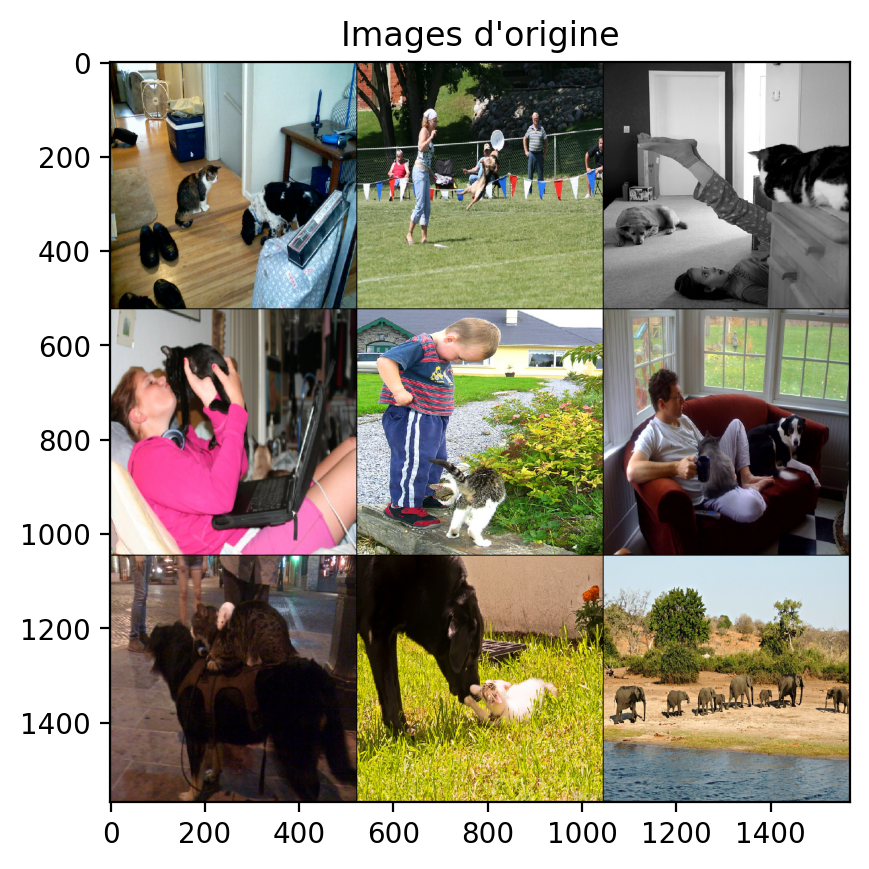

In [ ]:
if not os.path.isfile("coco_sample.pth"): # Si le fichier n'est pas déjà téléchargé
  os.system("wget https://httpmail.onera.fr/21/050a4e5c4611d260c1b8035b5dc8617eO1A12h/coco_sample.pth") # On le télécharge

img = torch.load("coco_sample.pth").to(device) # On importe les données et on les mets dans le GPU
print(img.shape) # On a 9 images RGB 520x520

visualize_images(img,"Images d'origine") # On les affiche

les 9 images étant chargées, on peut leur appliquer un modèle deeplab pré-appris comme
torchvision.models.segmentation.DeepLabV3_ResNet50_Weights

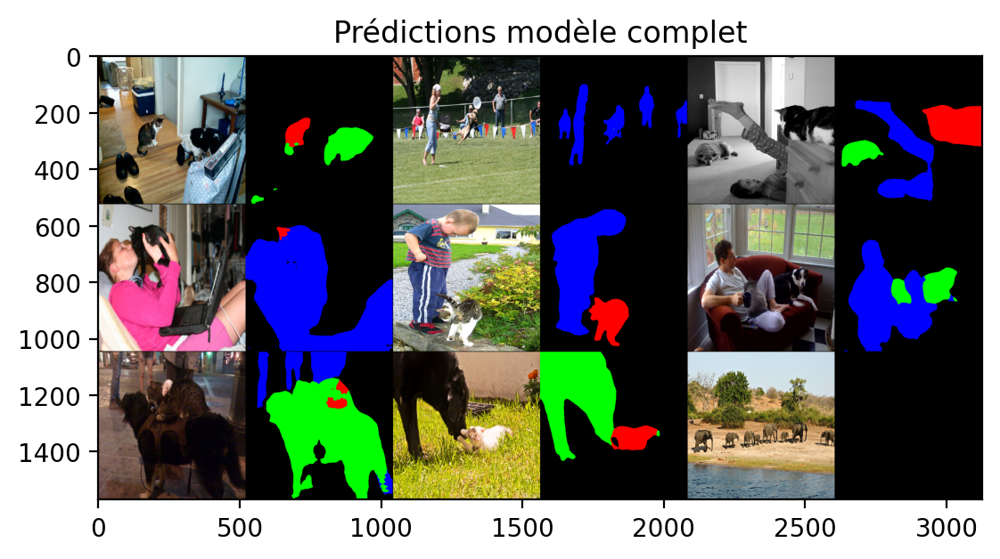

In [ ]:
W = torchvision.models.segmentation.DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1 # On charge les poids
net = torchvision.models.segmentation.deeplabv3_resnet50(weights=W).eval() # On crée le réseau avec les poids que l'on a déja chargé

net.to(device) # On déplace le réseau sur le GPU si disponible

with torch.no_grad(): # On n'entraine pas le modèle
  x = normalize(img) # Normalisation de l'image
  z = net(x)["out"] # on prédit des cartes de score de confiance
  z = z[:,[0,8,12,15],:,:] # on garde background, person, cat et dog
  _,z = z.max(1) # on prend le meilleur score

z_unattacked_full = z

visualize_prediction(x,z_unattacked_full,"Prédictions modèle complet") # On affiche les prédictions

Le résultat est loin d'être parfait mais on voit que le réseau est "fonctionnel" (il s'agit d'un backbone resnet - au fait beaucoup mieux aujourd'hui mais il faut aller chercher les modèles ailleurs...).

On peut en tester un autre plus rapide (et moins bon) comme torchvision.models.segmentation.DeepLabV3_MobileNet_V3_Large_Weights:

Downloading: "https://download.pytorch.org/models/deeplabv3_mobilenet_v3_large-fc3c493d.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_mobilenet_v3_large-fc3c493d.pth
100%|██████████| 42.3M/42.3M [00:00<00:00, 116MB/s]


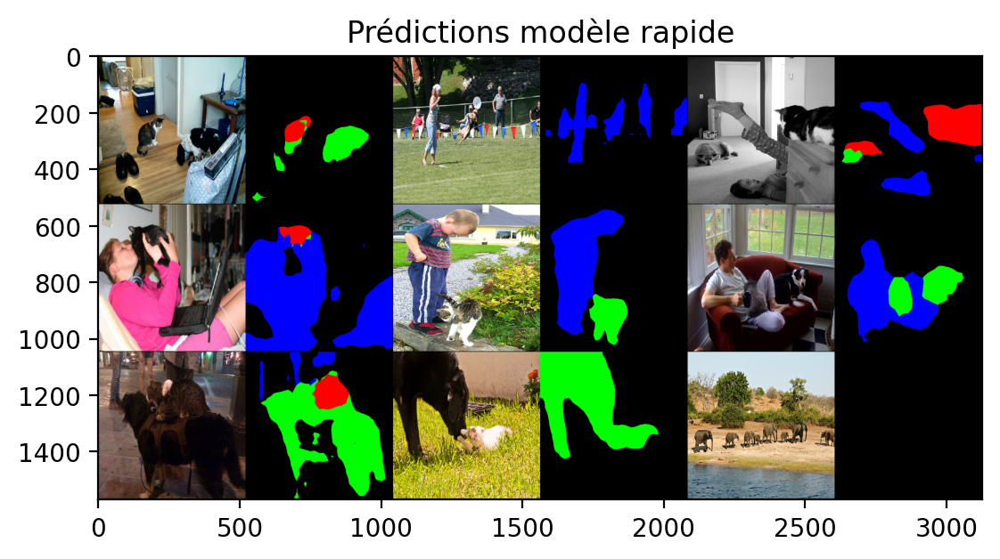

In [ ]:
W = torchvision.models.segmentation.DeepLabV3_MobileNet_V3_Large_Weights.COCO_WITH_VOC_LABELS_V1
net = torchvision.models.segmentation.deeplabv3_mobilenet_v3_large(weights=W).eval()

net.to(device) # On déplace le réseau sur le GPU si disponible


with torch.no_grad():
  x = normalize(img)
  z = net(x)["out"] # on prédit des cartes de score de confiance
  z_unattacked_fast_intermediate = z[:,[0,8,12,15],:,:] # on garde background, person, cat et dog
  _,z = z_unattacked_fast_intermediate.max(1) # on prend le meilleur score

z_unattacked_fast = z

visualize_prediction(x,z_unattacked_fast,"Prédictions modèle rapide")



**Question 1** : créer une attaque quelconque contre un réseau (dite *untargeted*)

Méthode 1 :
attaque standard "white box"
(ajout d'un petit bruit)


0 0.13328175246715546
1 0.2112203687429428
2 0.4029964506626129
3 0.4451437294483185
4 0.5431239604949951


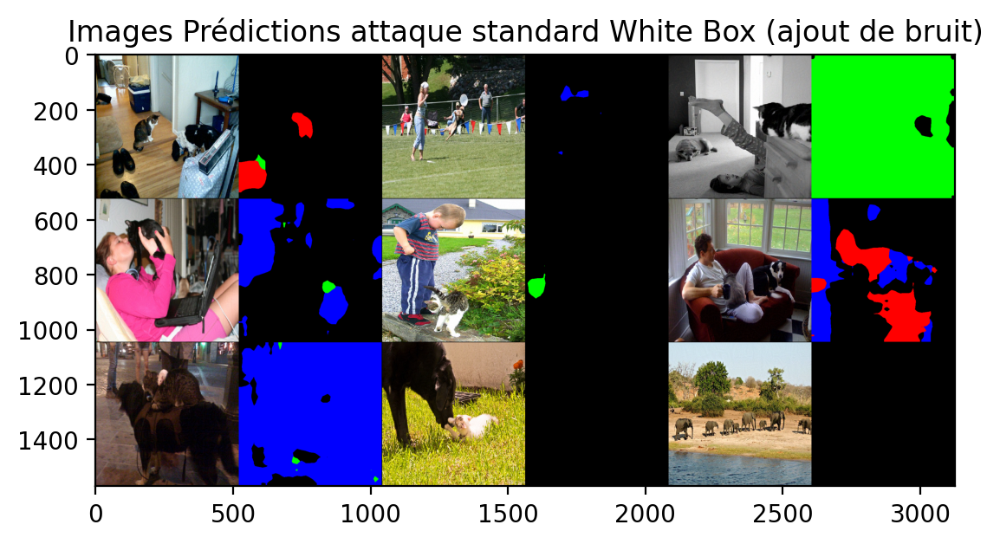

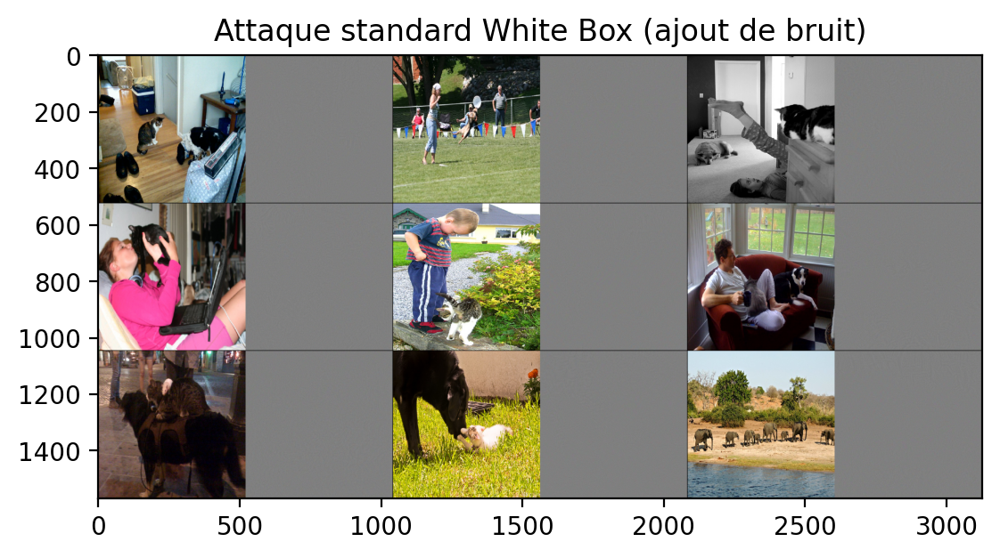

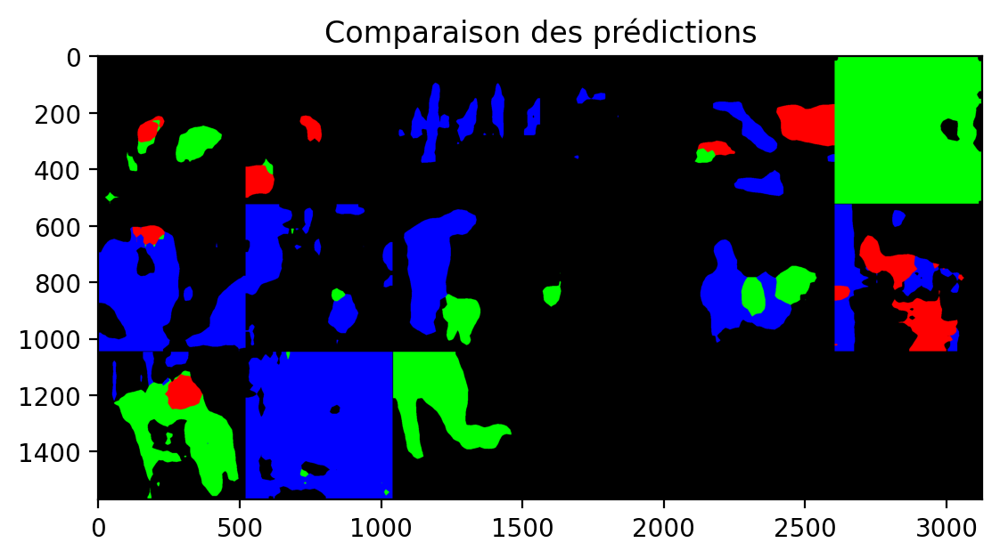

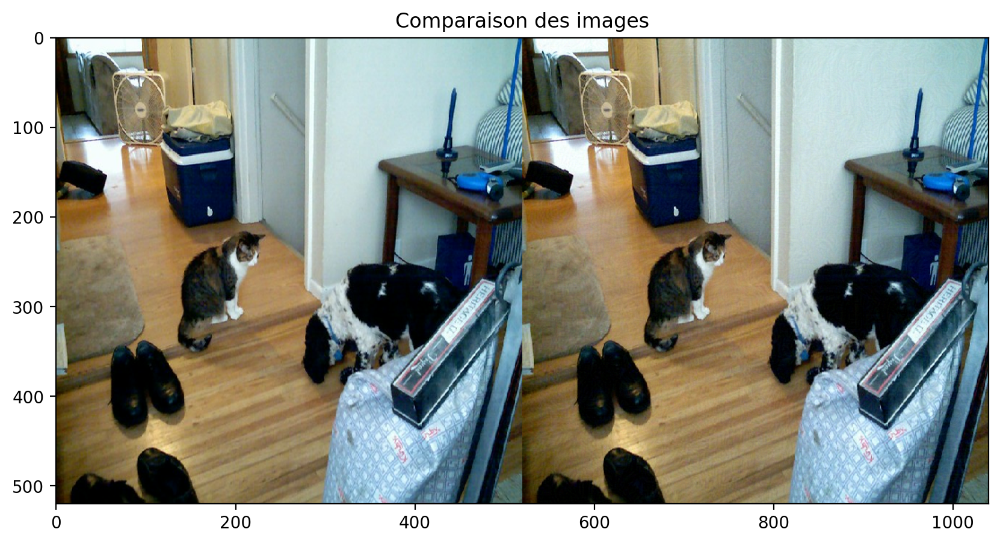

In [ ]:
attaque = torch.nn.Parameter(torch.zeros_like(x))
defaultW = torchvision.models.segmentation.DeepLabV3_MobileNet_V3_Large_Weights.COCO_WITH_VOC_LABELS_V1
defaultNet = torchvision.models.segmentation.deeplabv3_mobilenet_v3_large(weights=defaultW).eval().to(device)

# Descente de gradient
def descente_grad_non_ciblee(attaque,nb_iter=10,extremum="max",limite_perturb=10,W=defaultW,net=defaultNet):
  # Fonction de perte
  cefunction = torch.nn.CrossEntropyLoss()

  # Optimiseur pour optimiser la perturbation
  optimizer = torch.optim.SGD([attaque], lr=0.005)

  for i in range(nb_iter):
      z = net(normalize(img + attaque))["out"]  # On passe les images avec perturbation
      y = torch.argmax(z, dim=1)  # Prendre la classe avec le score le plus élevé (classes prédites)

      ce = cefunction(z, y)  # Calcul de la fonction de perte (cross-entropy)
      print(i, float(ce))

      if extremum == "max":
        ce = -ce  # On maximise la perte pour tromper le modèle (attaque)

      # sinon, on laisse ce car on veut minimser la perte (utile pour l'attaque ciblée)

      # Calcul des gradients et mise à jour de l'attaque
      optimizer.zero_grad()
      ce.backward()
      attaque.grad = attaque.grad.sign()  # Perturbation basée sur le signe des gradients
      optimizer.step()

      # Contrôler l'attaque pour qu'elle soit invisible
      with torch.no_grad():
          attaque = torch.clamp(attaque, -limite_perturb/255, +limite_perturb/255)  # Limiter la perturbation

      # il semble que les lignes ci dessous causent des problèmes

      # # S'assurer que l'attaque ne sort pas de la plage [0, 1] pour les images
      # lowbound = -x
      # uppbound = 1 - x
      # attaque = lowbound * (attaque < lowbound).float() + uppbound * (attaque > uppbound).float() + attaque * (attaque >= lowbound).float() * (attaque <= uppbound).float()

      attaque = torch.nn.Parameter(attaque.clone())  # Mémorisation de l'attaque
      optimizer = torch.optim.SGD([attaque], lr=0.005)  # Réinitialiser l'optimiseur

  return attaque

attaque = descente_grad_non_ciblee(attaque,nb_iter=5,extremum="max",limite_perturb=10)

# Re-définition du réseau (dans le cas où les cellules sont exécutées dans le désordre)
net = torchvision.models.segmentation.deeplabv3_mobilenet_v3_large(weights=defaultW).eval().to(device)

# Visualisation des résultats de la segmentation
with torch.no_grad():
    z = net(normalize(img + attaque))["out"]  # Passer l'image attaquée dans le modèle
    z = z[:, [0, 8, 12, 15], :, :]  # Sélectionner les classes: background, person, cat, dog
    _, z = z.max(1)  # Choisir la classe avec le score le plus élevé

# Copie (pour pouvoir réutiliser plus loin)
z_attacked_untargeted_fast = torch.clone(z)

# Visualisation des prédictions
visualize_prediction(normalize(img + attaque), z_attacked_untargeted_fast, "Images Prédictions attaque standard White Box (ajout de bruit)")

#Visualisation de l'attaque
image_and_perturbation(normalize(img),attaque,"Attaque standard White Box (ajout de bruit)")

# Comparaison des prédictions avec les images de base:
compare_predictions(z_unattacked_fast, z_attacked_untargeted_fast, "Comparaison des prédictions")

# On compare la première image avec la version attaquée :
compare_one_image(normalize(img[0]), normalize(img[0] + attaque[0]), "Comparaison des images")

Méthode 2 : attaque par patchs.

Nous avons d'abord testé avec un seul patch puis plusieurs pour avoir une meilleure attaque.

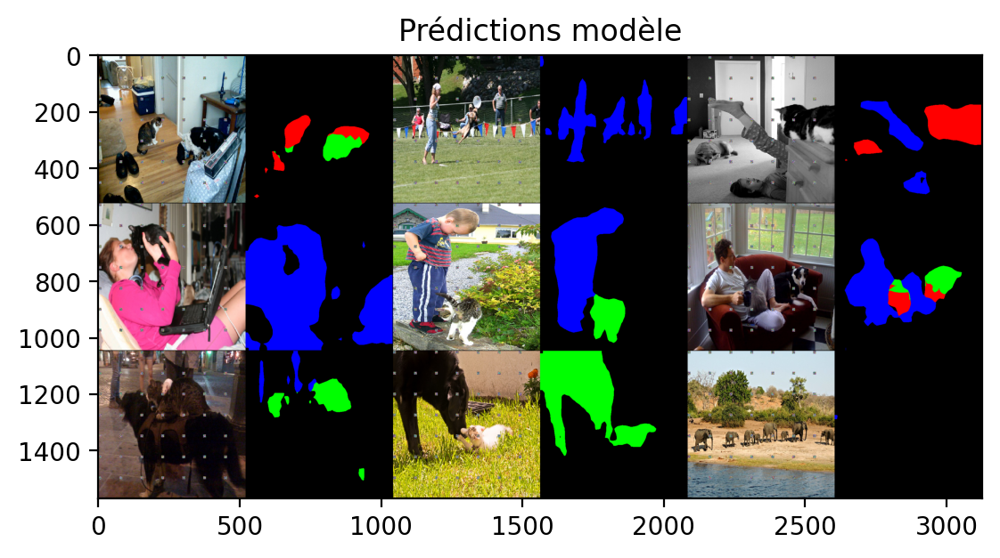

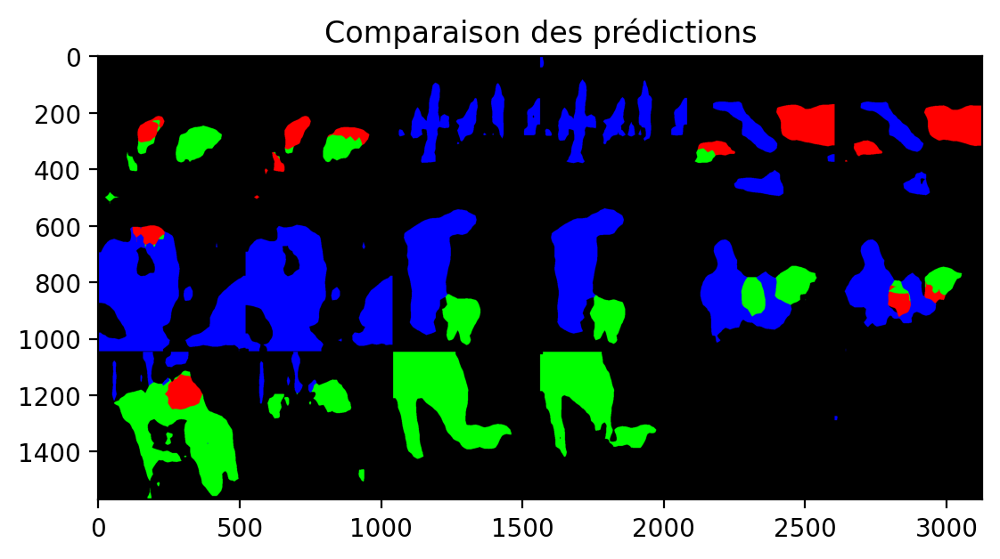

In [ ]:
# Attaque standard par patch "white box"
type_of_patch = "plusieurs patchs aléatoires v2" # divers types de patchs

mask = torch.zeros(9,3,520,520).to(device)

if type_of_patch == "patch noir":
  mask[:,:,240:280,240:280] = 1
  img_attacked = img*(1-mask)

elif type_of_patch == "patch aléatoire v1":
  mask[:,:,230:290,230:290] = rand()
  img_attacked = img*(1-mask)

elif type_of_patch == "patch aléatoire v2":
  mask[:,:,240:280,240:280] = 1
  attaque = torch.nn.Parameter(torch.rand(9,3,520,520)).to(device)
  img_attacked = img*(1-mask) + mask*attaque

elif type_of_patch == "plusieurs patchs aléatoires v1":
  k = 7 # nombre de patchs sur une ligne
  patch_size = 15
  for i in range(k):
    for j in range(k):
      repere = int(520/k)
      mask[:,:,i*repere:i*repere+patch_size,j*repere:j*repere+patch_size] = rand()/2
  img_attacked = img*(1-mask)

elif type_of_patch == "plusieurs patchs aléatoires v2":
  k = 7 # nombre de patchs sur une ligne
  patch_size = 10
  for i in range(k):
    for j in range(k):
      repere = int(520/k)
      mask[:,:,i*repere:i*repere+patch_size,j*repere:j*repere+patch_size] = 1
  attaque = torch.nn.Parameter(torch.rand(9,3,520,520)).to(device)
  img_attacked = img*(1-mask) + mask*attaque

elif type_of_patch == "plusieurs patchs optimisés":
  k = 7 # nombre de patchs sur une ligne
  patch_size = 10
  for i in range(k):
    for j in range(k):
      repere = int(520/k)
      mask[:,:,i*repere:i*repere+patch_size,j*repere:j*repere+patch_size] = 1
  attaque = torch.nn.Parameter(torch.rand(9,3,520,520)).to(device)
  attaque = descente_grad_non_ciblee(attaque,nb_iter=5)
  img_attacked = img*(1-mask) + mask*attaque

##
W = torchvision.models.segmentation.DeepLabV3_MobileNet_V3_Large_Weights.COCO_WITH_VOC_LABELS_V1
net = torchvision.models.segmentation.deeplabv3_mobilenet_v3_large(weights=W).eval()

net.to(device)



normalize = torchvision.transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])

with torch.no_grad():
  x = normalize(img_attacked)
  z = net(x)["out"] # on prédit des cartes de score de confiance
  z = z[:,[0,8,12,15],:,:] # on garde background, person, cat et dog
  _,z = z.max(1) # on prend le meilleur score

# visualisation des prédictions
visualize_prediction(x,z,"Prédictions modèle")

compare_predictions(z_unattacked_fast, z, "Comparaison des prédictions")

La méthode avec patchs est moins concluante que la méthode précédente avec l'ajout d'un bruit sur toute l'image. En effet, les patchs sont moins discrets et l'attaque perturbe moins bien le réseau. En effet, les prédictions restent similaires, bien que les formes des animaux soient légèrement modifiés et parfois même la classe d'un individu modifié.

C'est le cas même pour des patchs optimisés : les résultats ne sont perturbés que localement. Nous avons essayé qu'avec un nombre faible d'itérations (5) pour éviter des calculs trop longs (au-delà de quelques minutes). Peut-être qu'augmenter le nombre d'itérations améliorerait les résultats, mais nous ne pensons pas qu'il pourrait réussir aussi bien que la première méthode dans le cas de la segmentation.

**Question 2** : créer une attaque qui conduit à une prédiction spécifique (dite *targeted*)

D'abord, on faire en sorte que le modèle prédise que toute l'image est de la même classe.

0 7.544641494750977
1 1.8850826025009155
2 0.3998217284679413
3 0.11815165728330612
4 0.021999157965183258


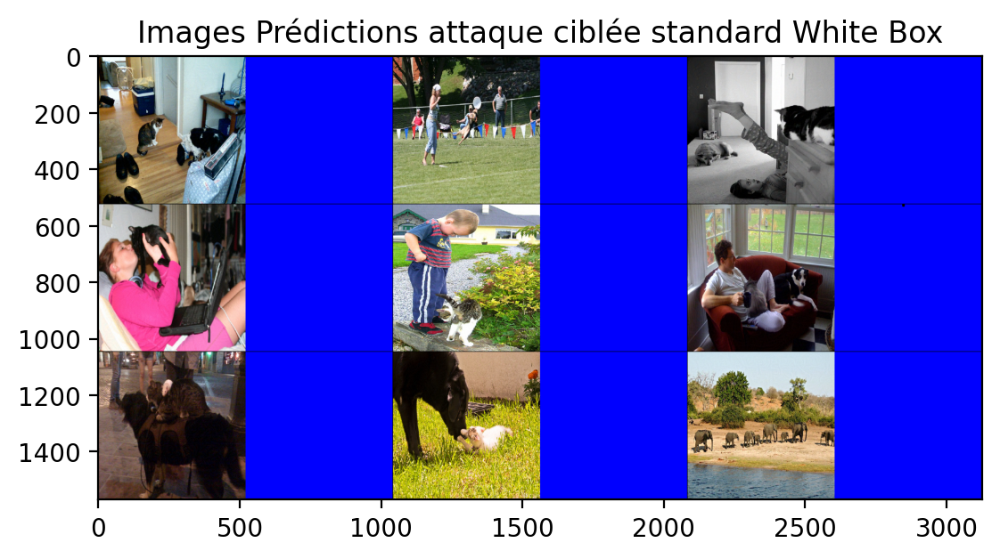

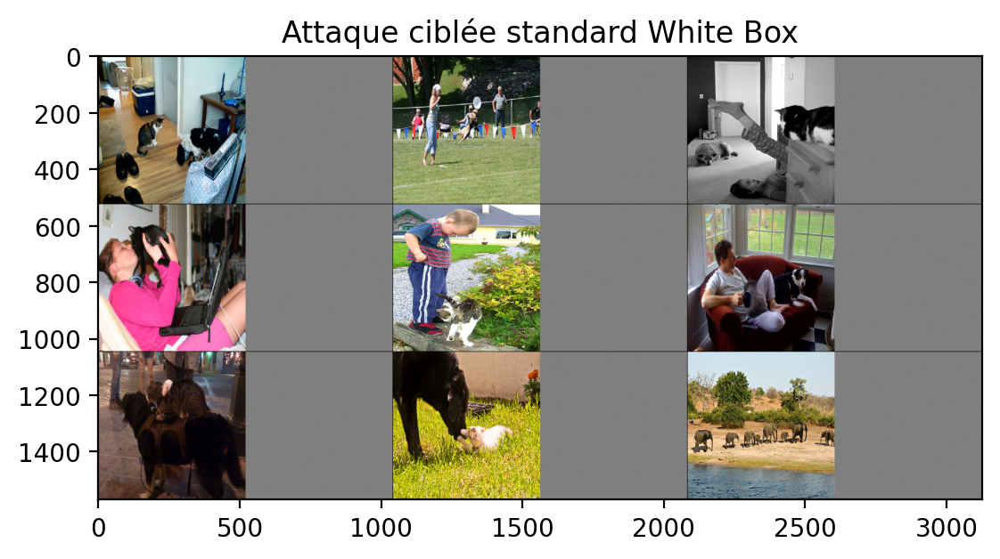

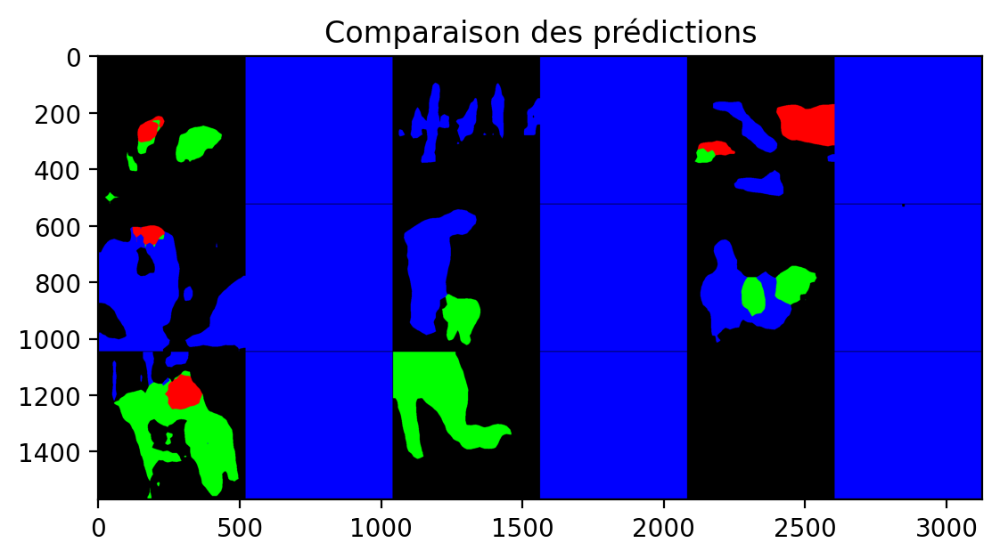

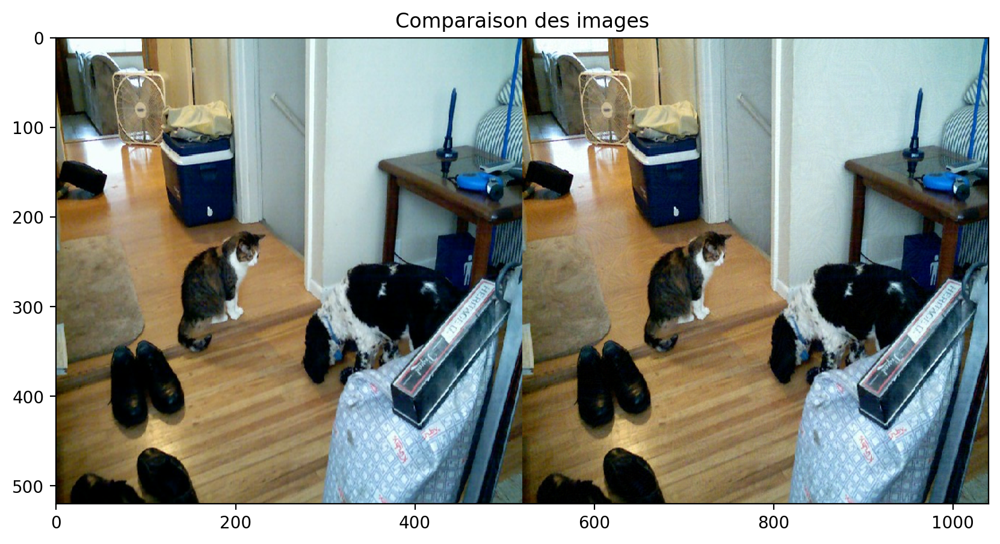

In [ ]:
attaque = torch.nn.Parameter(torch.zeros_like(x))


# Toute l'image est prédite comme ayant la même classe
classe = 15 # background : 0, person : 8, cat : 12, dog : 15
y = classe * torch.ones(9,520,520).long()
y = y.to(device)

# Descente de gradient
def descente_grad_ciblee(attaque,y_voulu,nb_iter=10,extremum="max",limite_perturb=10):
  # Fonction de perte
  cefunction = torch.nn.CrossEntropyLoss()

  # Optimiseur pour optimiser la perturbation
  optimizer = torch.optim.SGD([attaque], lr=0.005)

  for i in range(nb_iter):
      z = net(normalize(img + attaque))["out"]  # On passe les images avec perturbation
      y = y_voulu  # Prendre la prédiction que l'on souhaite

      ce = cefunction(z, y)  # Calcul de la fonction de perte (cross-entropy)
      print(i, float(ce))

      if extremum == "max":
        ce = -ce  # On maximise la perte pour tromper le modèle (attaque)

      # sinon, on laisse ce car on veut minimser la perte (utile pour l'attaque ciblée)

      # Calcul des gradients et mise à jour de l'attaque
      optimizer.zero_grad()
      ce.backward()
      attaque.grad = attaque.grad.sign()  # Perturbation basée sur le signe des gradients
      optimizer.step()

      # Contrôler l'attaque pour qu'elle soit invisible
      with torch.no_grad():
          attaque = torch.clamp(attaque, -limite_perturb/255, +limite_perturb/255)  # Limiter la perturbation

      # il semble que les lignes ci dessous causent des problèmes

      # # S'assurer que l'attaque ne sort pas de la plage [0, 1] pour les images
      # lowbound = -x
      # uppbound = 1 - x
      # attaque = lowbound * (attaque < lowbound).float() + uppbound * (attaque > uppbound).float() + attaque * (attaque >= lowbound).float() * (attaque <= uppbound).float()

      attaque = torch.nn.Parameter(attaque.clone())  # Mémorisation de l'attaque
      optimizer = torch.optim.SGD([attaque], lr=0.005)  # Réinitialiser l'optimiseur

  return attaque

attaque = descente_grad_ciblee(attaque,y,nb_iter=5,extremum="min",limite_perturb=100)

# Visualisation des résultats de la segmentation
with torch.no_grad():
    z = net(normalize(img + attaque))["out"]  # Passer l'image attaquée dans le modèle
    z = z[:, [0, 8, 12, 15], :, :]  # Sélectionner les classes: background, person, cat, dog
    _, z = z.max(1)  # Choisir la classe avec le score le plus élevé

# Visualisation des prédictions
visualize_prediction(normalize(img + attaque), z, "Images Prédictions attaque ciblée standard White Box")

#Visualisation de l'attaque
image_and_perturbation(normalize(img),attaque,"Attaque ciblée standard White Box")

# Comparaison des prédictions avec les images de base:
compare_predictions(z_unattacked_fast, z, "Comparaison des prédictions")

# On compare la première image avec la version attaquée :
compare_one_image(normalize(img[0]), normalize(img[0] + attaque[0]), "Comparaison des images")

Maintenant, on essaie de ne modifier que les classes des différentes formes de l'image (ne changer que la couleur de la forme humaine par exemple et ne pas changer la forme de l'humain).

On peut tenter par exemple d'échanger les prédictions entre chat et chiens.

0 2.414574384689331
1 1.1659245491027832
2 0.8030813932418823
3 0.8117255568504333
4 0.6361435651779175
5 0.31603723764419556
6 0.8041787147521973
7 0.7409201860427856
8 0.2100890576839447
9 0.346404105424881


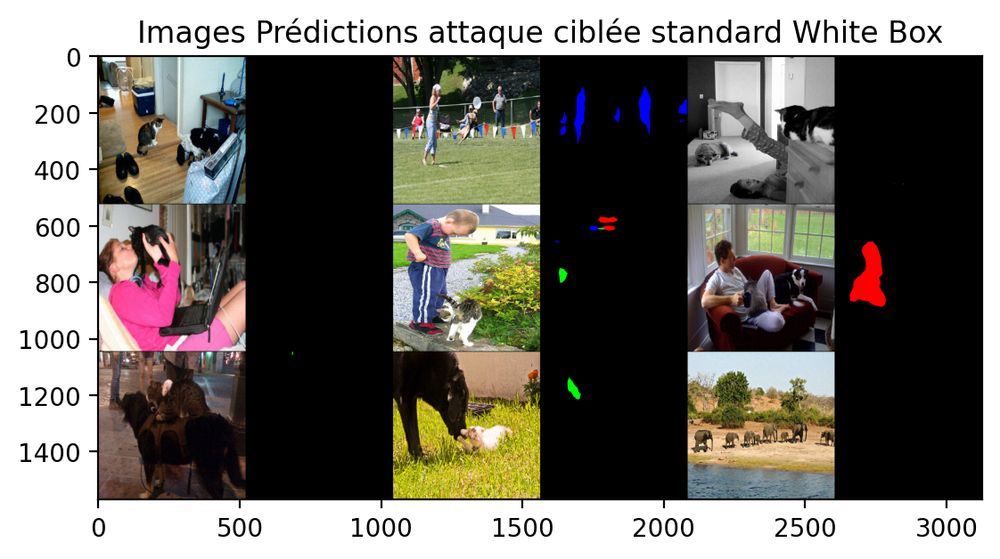

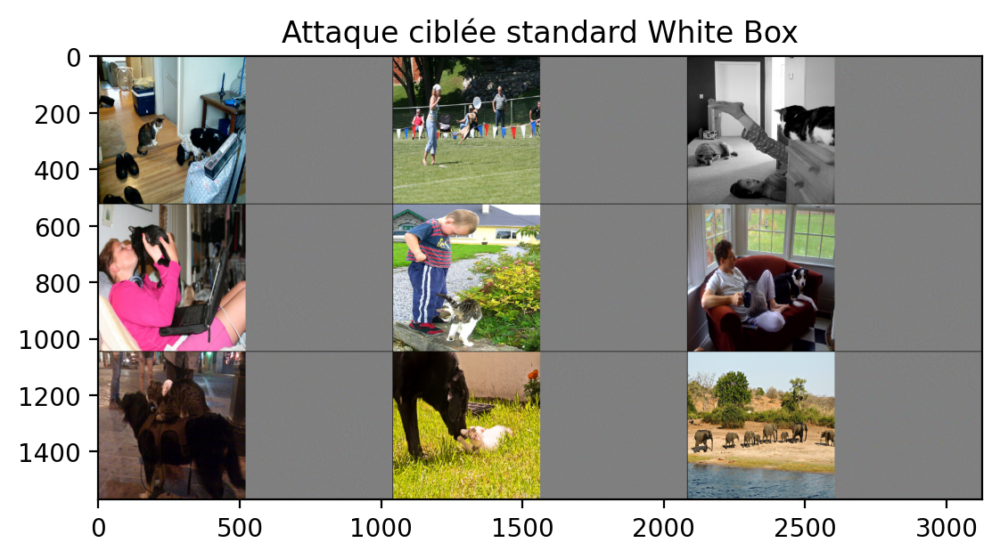

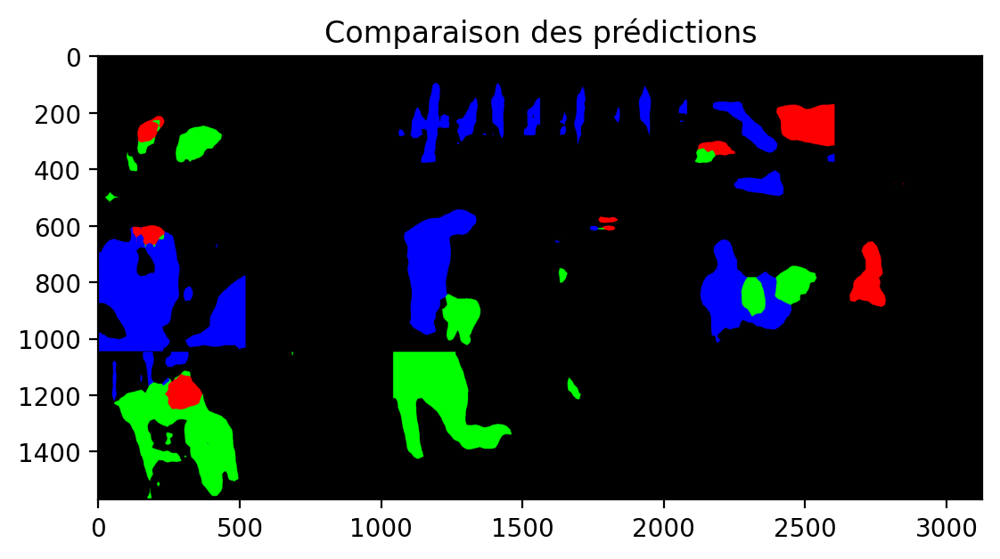

In [ ]:
attaque = torch.nn.Parameter(torch.zeros_like(x))

y = torch.argmax(z_unattacked_fast_intermediate,dim=1)
# On effectue un échange entre les chats et les chiens
y = torch.where(y==12,-1,y)
y = torch.where(y==15,12,y)
y = torch.where(y==-1,15,y)
y = y.long()

#visualize_prediction(normalize(img), z_unattacked_fast, "Images Prédictions non attaqué")

# Descente de gradient
def descente_grad_ciblee2(attaque,nb_iter=10,extremum="max",limite_perturb=10):
  # Fonction de perte
  cefunction = torch.nn.CrossEntropyLoss()

  # Optimiseur pour optimiser la perturbation
  optimizer = torch.optim.SGD([attaque], lr=0.005)

  for i in range(nb_iter):
      z = net(normalize(img + attaque))["out"]  # On passe les images avec perturbation

      ce = cefunction(z, y)  # Calcul de la fonction de perte (cross-entropy)
      print(i, float(ce))

      if extremum == "max":
        ce = -ce  # On maximise la perte pour tromper le modèle (attaque)

      # sinon, on laisse ce car on veut minimiser la perte (utile pour l'attaque ciblée)

      # Calcul des gradients et mise à jour de l'attaque
      optimizer.zero_grad()
      ce.backward()
      attaque.grad = attaque.grad.sign()  # Perturbation basée sur le signe des gradients
      optimizer.step()

      # Contrôler l'attaque pour qu'elle soit invisible
      with torch.no_grad():
          attaque = torch.clamp(attaque, -limite_perturb/255, +limite_perturb/255)  # Limiter la perturbation

      attaque = torch.nn.Parameter(attaque.clone())  # Mémorisation de l'attaque
      optimizer = torch.optim.SGD([attaque], lr=0.005)  # Réinitialiser l'optimiseur

  return attaque

attaque = descente_grad_ciblee2(attaque,nb_iter=10,extremum="min",limite_perturb=10)

# Visualisation des résultats de la segmentation
with torch.no_grad():
    z = net(normalize(img + attaque))["out"]  # Passer l'image attaquée dans le modèle
    z = z[:, [0, 8, 12, 15], :, :]  # Sélectionner les classes: background, person, cat, dog
    _, z = z.max(1)  # Choisir la classe avec le score le plus élevé

# Visualisation des prédictions
visualize_prediction(normalize(img + attaque), z, "Images Prédictions attaque ciblée standard White Box")

#Visualisation de l'attaque
image_and_perturbation(normalize(img),attaque,"Attaque ciblée standard White Box")

# Comparaison des prédictions avec les images de base:
compare_predictions(z_unattacked_fast, z, "Comparaison des prédictions")

On remarque que cela ne fonctionne pas tout à fait comme souhaité. Les résultats paraissent un peu aléatoires.


**Question 3** : évolution de la performance vis-à-vis de la norme autorisée de l'attaque.

On fait varier *limite_perturb*.

0 0.13328176736831665
1 0.20658786594867706
2 0.3502045273780823
0 0.13328178226947784
1 0.21122056245803833
2 0.40297749638557434
0 0.13328178226947784
1 0.21122010052204132
2 0.40296846628189087
0 0.13328178226947784
1 0.21122033894062042
2 0.4029962420463562
0 0.13328175246715546
1 0.21122026443481445
2 0.40299591422080994
0 0.13328178226947784
1 0.2112203687429428
2 0.4029962420463562
0 0.13328175246715546
1 0.21122010052204132
2 0.40300774574279785
0 0.13328178226947784
1 0.21122048795223236
2 0.4029819071292877
0 0.13328178226947784
1 0.21122048795223236
2 0.4029977321624756
0 0.13328178226947784
1 0.21122007071971893
2 0.403017520904541
0 0.13328178226947784
1 0.21122027933597565
2 0.40303558111190796
0 0.13328178226947784
1 0.2112203687429428
2 0.40299591422080994
0 0.13328178226947784
1 0.21122047305107117
2 0.4029964208602905
0 0.13328178226947784
1 0.21122048795223236
2 0.40299686789512634
0 0.13328178226947784
1 0.211220383644104
2 0.40298688411712646
0 0.13328178226947784


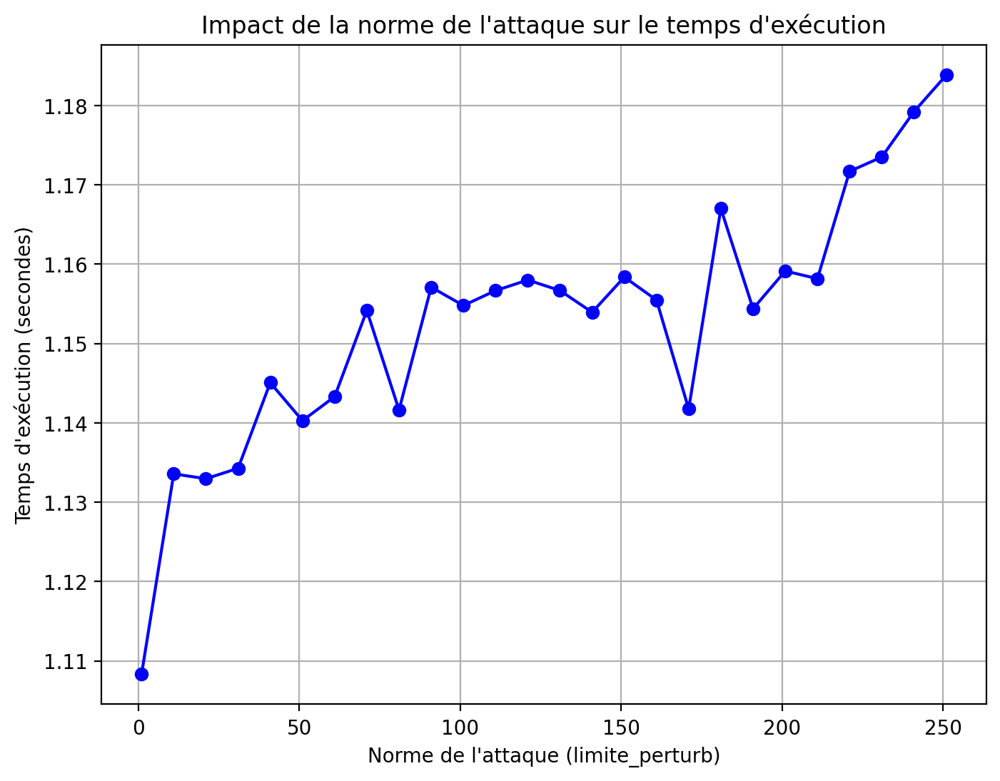

In [ ]:
# Liste des différentes valeurs de limite_perturb
perturb_values = list(range(1, 256, 10))

# Liste pour stocker les temps d'exécution
execution_times = []

for perturb_value in perturb_values:
    attaque = torch.nn.Parameter(torch.zeros_like(x))
    temps_initial = time.time()  # Temps de départ
    attaque = descente_grad_non_ciblee(attaque, nb_iter=3, extremum="max", limite_perturb=perturb_value)
    temps_final = time.time()  # Temps de fin
    execution_times.append(temps_final - temps_initial)  # Stockage du temps d'exécution

# Création du graphique
plt.figure(figsize=(8, 6))
plt.plot(perturb_values, execution_times, marker='o', linestyle='-', color='b')


plt.title("Impact de la norme de l'attaque sur le temps d'exécution")
plt.xlabel("Norme de l'attaque (limite_perturb)")
plt.ylabel("Temps d'exécution (secondes)")


plt.grid(True)

# Afficher le graphique
plt.show()


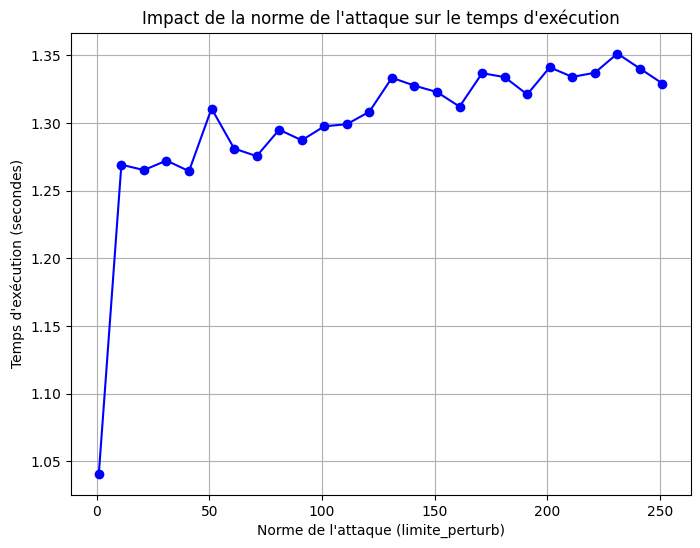

0 2.414574384689331
1 4.175743579864502
2 4.583659648895264
0 2.414574384689331
1 4.219850063323975
2 5.373266696929932
0 2.414574384689331
1 4.219851970672607
2 5.373378753662109
0 2.414574384689331
1 4.219849586486816
2 5.373264312744141
0 2.414574384689331
1 4.219851970672607
2 5.373399257659912
0 2.41457462310791
1 4.219849586486816
2 5.373264312744141
0 2.41457462310791
1 4.219863414764404
2 5.373329162597656
0 2.414574384689331
1 4.219851970672607
2 5.373386859893799
0 2.41457462310791
1 4.219849586486816
2 5.373229026794434
0 2.41457462310791
1 4.219850063323975
2 5.373269081115723
0 2.414574384689331
1 4.219849586486816
2 5.373270511627197
0 2.414574384689331
1 4.219849109649658
2 5.373269081115723
0 2.414574384689331
1 4.219862937927246
2 5.373311996459961
0 2.41457462310791
1 4.219849109649658
2 5.373285293579102
0 2.414574384689331
1 4.219849109649658
2 5.37322998046875
0 2.414574384689331
1 4.219860553741455
2 5.37317419052124
0 2.414574384689331
1 4.219849586486816
2 5.373

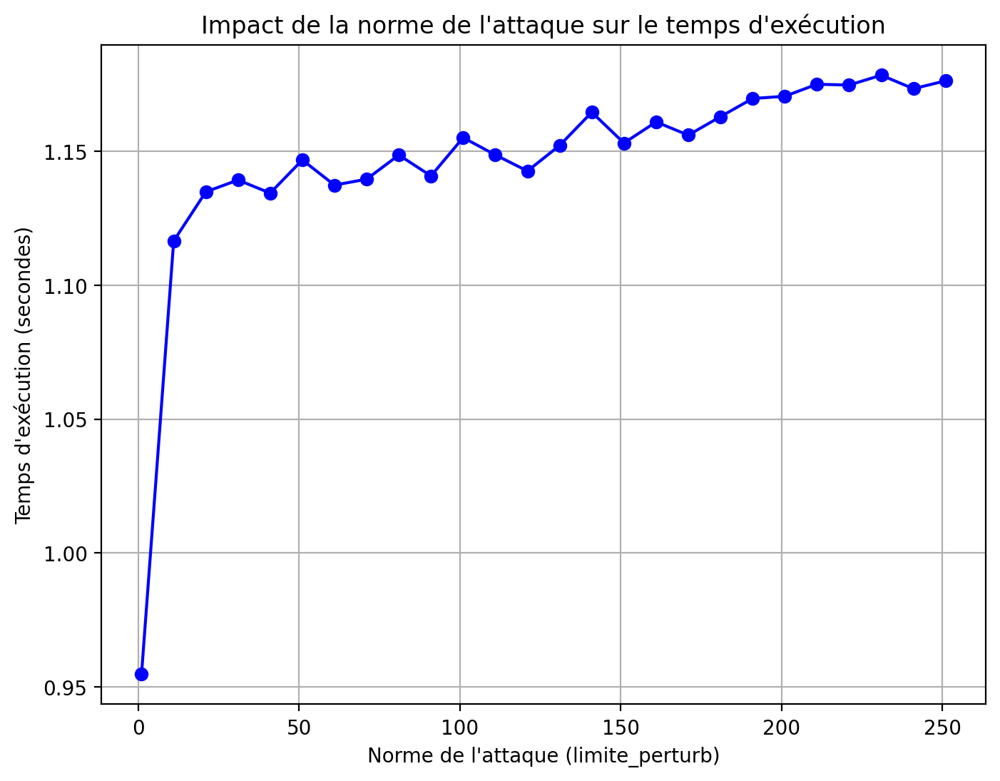

In [ ]:
for perturb_value in perturb_values:
    attaque = torch.nn.Parameter(torch.zeros_like(x))
    temps_initial = time.time()  # Temps de départ
    attaque = descente_grad_ciblee(attaque,y, nb_iter=3, extremum="max", limite_perturb=perturb_value)
    temps_final = time.time()  # Temps de fin
    execution_times.append(temps_final - temps_initial)  # Stockage du temps d'exécution

# Création du graphique
plt.figure(figsize=(8, 6))
plt.plot(perturb_values, execution_times, marker='o', linestyle='-', color='b')


plt.title("Impact de la norme de l'attaque sur le temps d'exécution")
plt.xlabel("Norme de l'attaque (limite_perturb)")
plt.ylabel("Temps d'exécution (secondes)")


plt.grid(True)

# Afficher le graphique
plt.show()


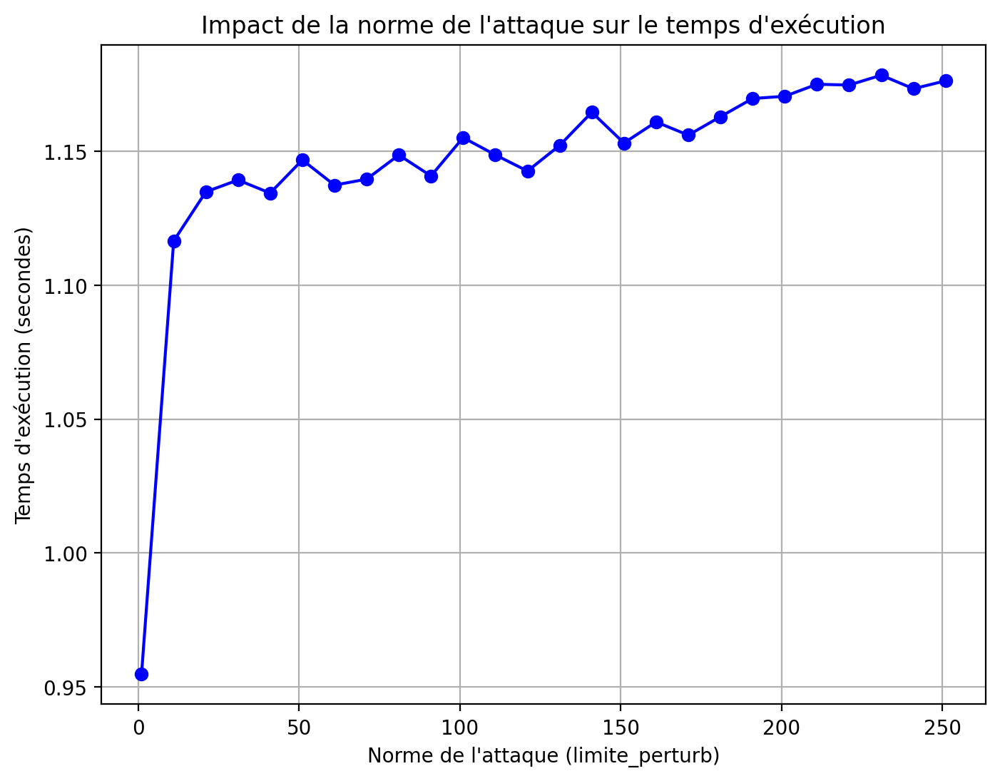

On observe sur ces graphiques que la norme de l'attaque influence la performance de l'algorithme en terme de temps d'exécution : cette durée est une fonction croissante et linéaire de la norme.

**Question 4 :** comment se comporte l'attaque sur un autre réseau ?

Nous avons obtenu une attaque sur le réseau plus rapide torchvision.models.segmentation.DeepLabV3_MobileNet_V3_Large_Weights. On teste alors cette attaque sur le premier réseau torchvision.models.segmentation.DeepLabV3_ResNet50_Weights.

0 0.13328176736831665
1 0.21122048795223236
2 0.4029862880706787
3 0.4454851746559143
4 0.5447223782539368


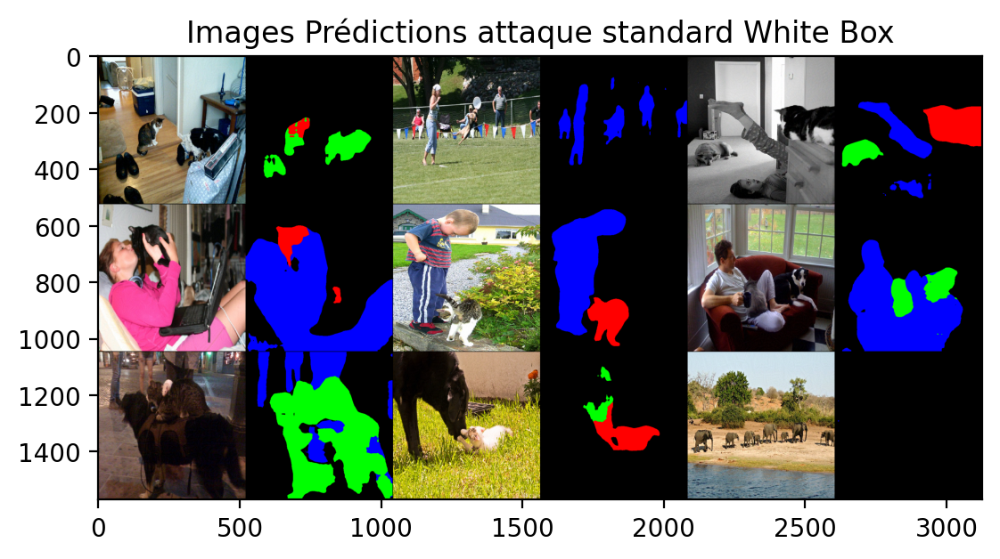

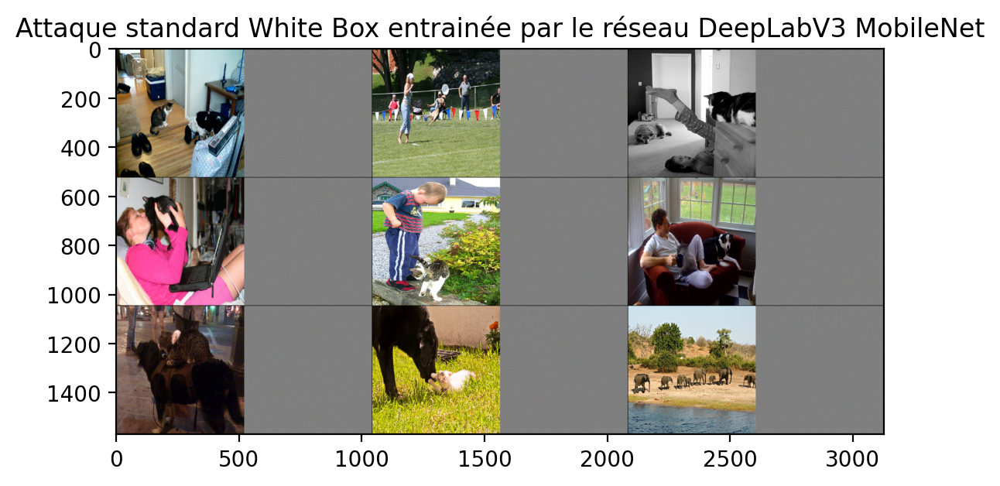

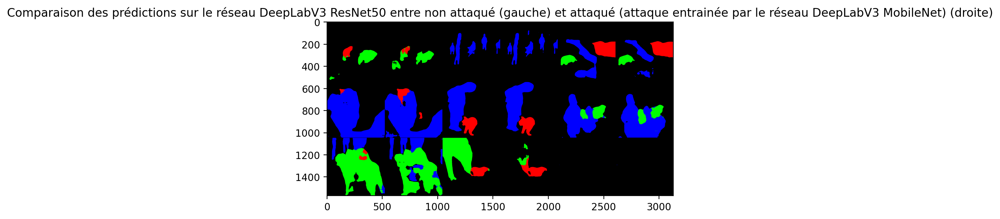

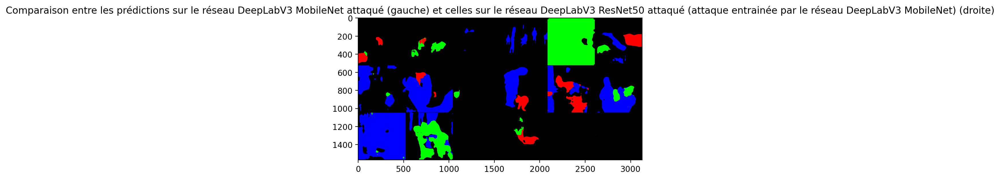

In [ ]:
attaque = torch.nn.Parameter(torch.zeros_like(img)).to(device)

# Descente de gradient
attaque = descente_grad_non_ciblee(attaque,nb_iter=5,extremum="max",limite_perturb=10)

# Test sur l'autre réseau
W = torchvision.models.segmentation.DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1 # On charge les poids
net = torchvision.models.segmentation.deeplabv3_resnet50(weights=W).eval() # On crée le réseau avec les poids que l'on a déja chargé
net.to(device)

# Visualisation des résultats de la segmentation
with torch.no_grad():
    z = net(normalize(img + attaque))["out"]  # Passer l'image attaquée dans le modèle
    z = z[:, [0, 8, 12, 15], :, :]  # Sélectionner les classes: background, person, cat, dog
    _, z = z.max(1)  # Choisir la classe avec le score le plus élevé

# Visualisation des prédictions
visualize_prediction(normalize(img + attaque), z, "Images Prédictions attaque standard White Box")

#Visualisation de l'attaque
image_and_perturbation(normalize(img),attaque,"Attaque standard White Box entrainée par le réseau DeepLabV3 MobileNet")

# Comparaison des prédictions avec les images de base:
compare_predictions(z_unattacked_full, z, "Comparaison des prédictions sur le réseau DeepLabV3 ResNet50 entre non attaqué (gauche) et attaqué (attaque entrainée par le réseau DeepLabV3 MobileNet) (droite)")
compare_predictions(z_attacked_untargeted_fast, z, "Comparaison entre les prédictions sur le réseau DeepLabV3 MobileNet attaqué (gauche) et celles sur le réseau DeepLabV3 ResNet50 attaqué (attaque entrainée par le réseau DeepLabV3 MobileNet) (droite)")


On voit que l'attaque entrainé sur le réseau MobileNet fonctionne nettement moins bien lorsqu'on effectue la prédiction avec l'autre réseau (DeepLabV3 ResNet50). L'attaque est donc spécialisée pour un réseau.

On essaye maintenant avec un nouveau réseau, FCN resnet50, qui n'est donc pas lié à DeepLabV3

0 0.13328178226947784
1 0.06241542845964432
2 0.03210211545228958
3 0.021708622574806213
4 0.017070062458515167


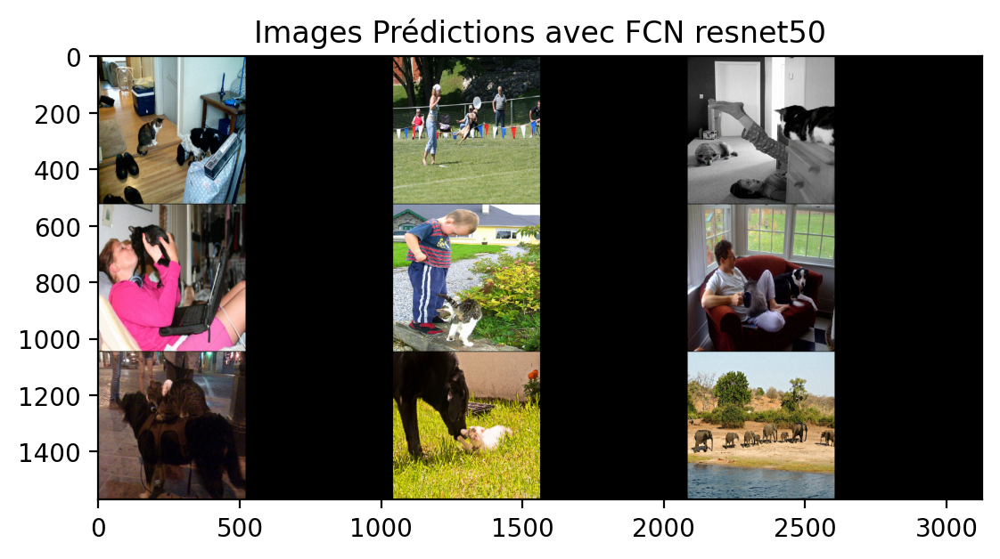

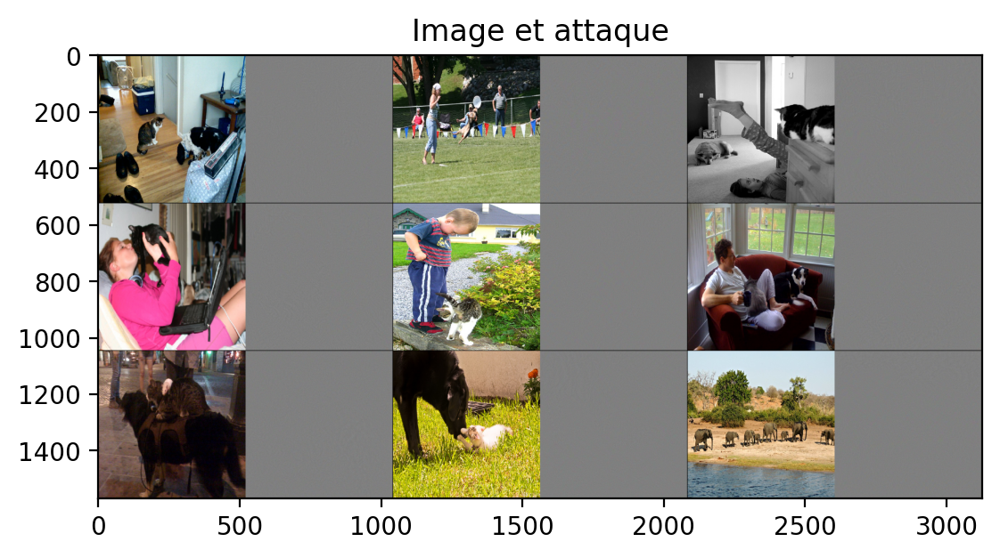

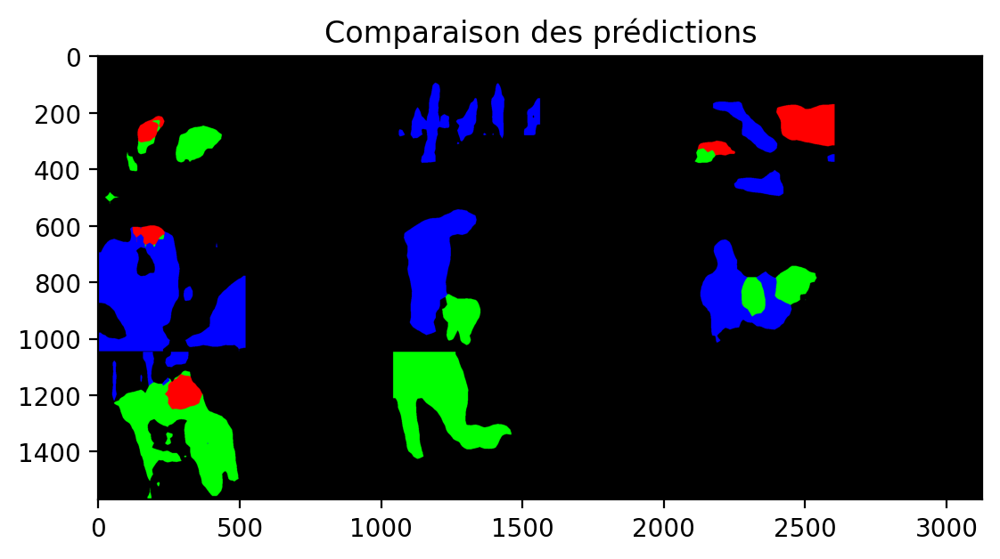

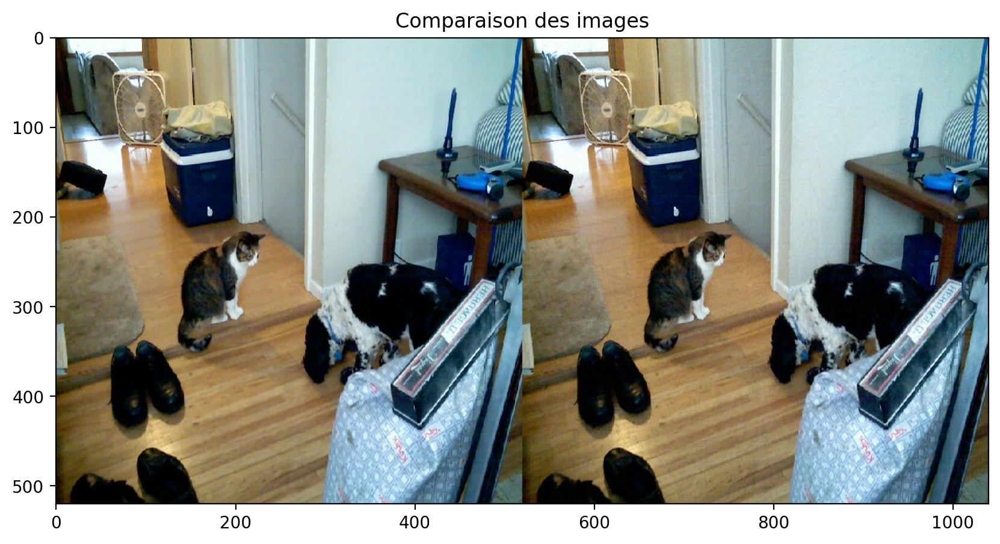

In [ ]:
import torch.nn as nn
import torch.optim as optim
from torchvision import models
from torchvision.models.segmentation import fcn_resnet50

##### Essai sur le modèle net = segmentation.fcn_resnet50(weights="DEFAULT")
#### Le fichier coco_path a expiré donc le test n'est pas disponible malheureusement (le chargement ne fonctionne pas)

# Charger le modèle de segmentation




# Initialisation de l'attaque
attaque = torch.zeros_like(img, requires_grad=True).to(device)

# Exécution de l'attaque
attaque = descente_grad_non_ciblee(attaque, nb_iter=5, extremum="min", limite_perturb=100) # On entraine avec DeepLabV3 Mobile

net = fcn_resnet50(weights='COCO_WITH_VOC_LABELS_V1').eval().to(device) # On prédit avec FCN Resnet50

# Visualisation des résultats
with torch.no_grad():
    z = net(normalize(img + attaque))["out"]
    z = z.argmax(1)  # Choix de la classe la plus probable



visualize_prediction(normalize(img + attaque), z, "Images Prédictions avec FCN resnet50")
image_and_perturbation(normalize(img), attaque, "Image et attaque")
compare_predictions(z_unattacked_fast, z, "Comparaison des prédictions")
compare_one_image(normalize(img[0]), normalize(img[0] + attaque[0]), "Comparaison des images")


Nous n'avons pas réussi à avoir de résultat convaincant avec ce réseau

**Question 5** : On apprend l'attaque sur un ensemble de réseaux

In [ ]:
attaque = torch.nn.Parameter(torch.zeros_like(img)).to(device)


torch.cuda.empty_cache()


# On importe nos deux réseaux

W = torchvision.models.segmentation.DeepLabV3_MobileNet_V3_Large_Weights.COCO_WITH_VOC_LABELS_V1
net1 = torchvision.models.segmentation.deeplabv3_mobilenet_v3_large(weights=W).eval().to(device)
net2=fcn_resnet50(weights='COCO_WITH_VOC_LABELS_V1').eval().to(device)


# Descente de gradient
def descente_grad_non_ciblee_deux_reseaux( net1,net2, attaque,nb_iter=10,extremum="max",limite_perturb=10,learningrate = 0.005):
  # Fonction de perte
  cefunction = torch.nn.CrossEntropyLoss()

  # Optimiseur pour optimiser la perturbation
  optimizer = torch.optim.SGD([attaque], lr=learningrate)

  for i in range(nb_iter):
      z1 = net1(normalize(img + attaque))["out"]  # On passe les images avec perturbation
      z2 = net2(normalize(img + attaque))["out"]
      z = (z1+z2)*0.5

      y = torch.argmax(z, dim=1)  # Prendre la classe avec le score le plus élevé (classes prédites)

      ce = cefunction(z, y)  # Calcul de la fonction de perte (cross-entropy)
      print(i, float(ce))

      if extremum == "max":
        ce = -ce  # On maximise la perte pour tromper le modèle (attaque)

      # sinon, on laisse ce car on veut minimser la perte (utile pour l'attaque ciblée)

      # Calcul des gradients et mise à jour de l'attaque
      optimizer.zero_grad()
      ce.backward()
      attaque.grad = attaque.grad.sign()  # Perturbation basée sur le signe des gradients
      optimizer.step()

      # Contrôler l'attaque pour qu'elle soit invisible
      with torch.no_grad():
          attaque = torch.clamp(attaque, -limite_perturb/255, +limite_perturb/255)  # Limiter la perturbation

      # il semble que les lignes ci dessous causent des problèmes

      # # S'assurer que l'attaque ne sort pas de la plage [0, 1] pour les images
      # lowbound = -x
      # uppbound = 1 - x
      # attaque = lowbound * (attaque < lowbound).float() + uppbound * (attaque > uppbound).float() + attaque * (attaque >= lowbound).float() * (attaque <= uppbound).float()

      attaque = torch.nn.Parameter(attaque.clone())  # Mémorisation de l'attaque
      optimizer = torch.optim.SGD([attaque], lr=0.005)  # Réinitialiser l'optimiseur

  return attaque

attaque = descente_grad_non_ciblee_deux_reseaux(net1,net2,attaque,nb_iter=10,extremum="max",limite_perturb=2)

# Visualisation des résultats de la segmentation pour nos deux réseaux
with torch.no_grad():
    z1 = net1(normalize(img + attaque))["out"]  # Passer l'image attaquée dans le modèle
    z1 = z1[:, [0, 8, 12, 15], :, :]  # Sélectionner les classes: background, person, cat, dog
    _, z1 = z1.max(1)  # Choisir la classe avec le score le plus élevé
    z2 = net2(normalize(img + attaque))["out"]
    z2 = z2[:, [0, 8, 12, 15], :, :]  # Sélectionner les classes: background, person, cat, dog
    _, z2 = z2.max(1)

# Visualisation des prédictions
visualize_prediction(normalize(img + attaque), z1, "Images Prédictions pour le réseau DeepLabV3 Mobile")
visualize_prediction(normalize(img + attaque), z2, "Images Prédictions pour le réseau FCN ResNet50")


# Comparaison des prédictions de l'attaque sur les deux réseaux
compare_predictions(z1, z2, "Comparaison des prédictions, DeepLabV3 Mobile à gauche, FCN ResNet50 à droite")

#Visualisation de l'attaque
image_and_perturbation(normalize(img),attaque,"Attaque en s'entrainant sur deux réseaux")

# On compare la première image avec la version attaquée :
compare_one_image(normalize(img[0]), normalize(img[0] + attaque[0]), "Comparaison des images")

OutOfMemoryError: CUDA out of memory. Tried to allocate 2.00 MiB. GPU 0 has a total capacity of 14.74 GiB of which 4.12 MiB is free. Process 3666 has 14.73 GiB memory in use. Of the allocated memory 14.43 GiB is allocated by PyTorch, and 186.53 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

Nous n'avons pas eu assez de mémoire GPU pour faire le test, nous l'avons réussi sur un notebook vierge mais là il faudrait supprimer un grand nombre de variables enregistrées